In [1]:
# load model

import glob
import os
import cv2
import torch
import pandas as pd
import numpy as np
import torchvision.transforms as transforms
from timm import create_model
import torch.nn.functional as F
from skimage import io, transform
import matplotlib.pyplot as plt
from models import Unet


# Paths
#video_path = r"C:\Users\avs20\Documents\GitHub\facemap\cam1_G7c1_1_10seconds.avi"
video_path = r"C:\Users\avs20\Documents\GitHub\facemap\Pain prototype_aaz9468s2.mov"
output_video_path = "output_video_with_keypoints_224x224.mp4"
model_path = r"C:\Users\avs20\Documents\GitHub\facemap\models\best_model.pt"
#model_path = r"C:\Users\avs20\Documents\GitHub\facemap\models_dolensek_facemap_noaug\best_model.pt"
#model_path = r"C:\Users\avs20\Documents\GitHub\facemap\models_unet_dolensek_facemap_unet_aug\best_model.pt"
#model_path = r"C:\Users\avs20\Documents\GitHub\facemap\models_unet_dolensek_facemap_moreaug\best_model.pt"

# Device setup
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define model loading function
def load_model(model_path, num_output_classes=24):
    model = Unet()
    #model = create_model("vit_base_patch16_224", pretrained=False, in_chans=1, num_classes=num_output_classes)
    model.load_state_dict(torch.load(model_path, map_location=device))
    model = model.to(device)
    model.eval()
    return model

# Load model
try:
    model = load_model(model_path)
    print("Model loaded successfully.")
except Exception as e:
    print(f"Error loading model: {e}")
    exit()

import cv2
import os

 # Define video path and output folder
#video_path = r'C:\Users\avs20\Documents\GitHub\facemap\cam1_G7c1_1_10seconds.avi'  # Update with the path to your video
video_path = r'C:\Users\avs20\Documents\GitHub\facemap\Pain prototype_aaz9468s2.mov' 
output_folder = 'frames'  # Folder to save frames

 # Ensure the output folder exists
os.makedirs(output_folder, exist_ok=True)

 # Set up video capture
cap = cv2.VideoCapture(video_path)
fps = int(cap.get(cv2.CAP_PROP_FPS))
frame_count = 0

 # Process each frame in the video
while cap.isOpened():
    if not cap.isOpened():
        print("Error: Unable to open the video file.")
    ret, frame = cap.read()
    if not ret:
        break
    
     # Resize the frame to 224x224
     #frame = cv2.resize(frame, (224, 224))

     # Save each frame as an image in the output folder
    frame_filename = os.path.join(output_folder, f"frame_{frame_count:04d}.jpg")
    cv2.imwrite(frame_filename, frame)

    frame_count += 1

 # Release resources
cap.release()
print(f"Frames saved to '{output_folder}' folder with 224x224 resolution.")


import os
import glob

# Define image location
IMG_LOC = r'C:\Users\avs20\Documents\GitHub\facemap\Inference_scripts\frames'

# Make folder called 'low_res' if it doesn't exist
low_res_folder = os.path.join(IMG_LOC, 'low_res')
if os.path.isdir(low_res_folder):
    print('Folder exists!')
else:
    os.makedirs(low_res_folder)
    print('Created low_res folder.')

# Find all jpg images in IMG_LOC
img_files = sorted(glob.glob(os.path.join(IMG_LOC, '*.jpg')))

# Check if any images were found
if not img_files:
    print("No .jpg images found in the specified directory.")
else:
    print(f"Found {len(img_files)} images.")

# specify height and width
h = w = 224

# read one image
img = plt.imread(img_files[0])

# find aspects of original image
h_org = img.shape[0]
w_org = img.shape[1]

Model loaded successfully.
Frames saved to 'frames' folder with 224x224 resolution.
Folder exists!
Found 300 images.


Directory 'C:\Users\avs20\Documents\GitHub\facemap\combined_images' is ready.


C:\Users\avs20\AppData\Local\Temp\ipykernel_3548\3399866496.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


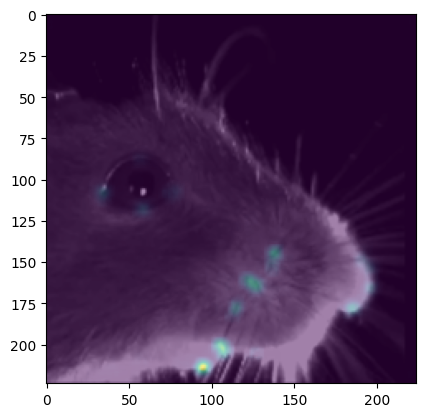

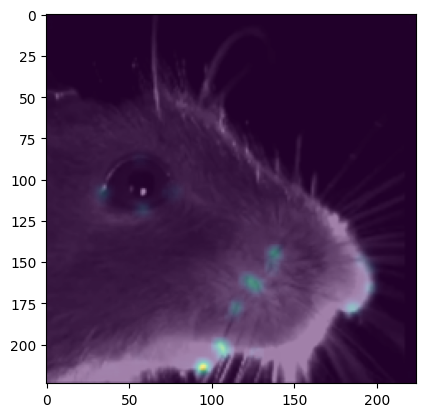

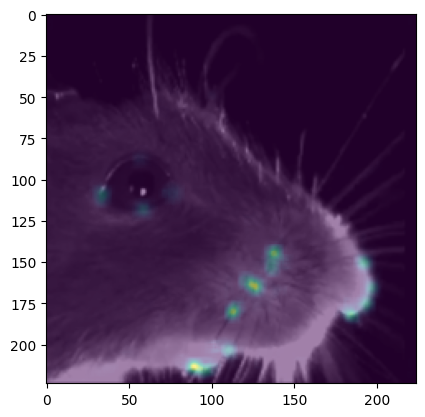

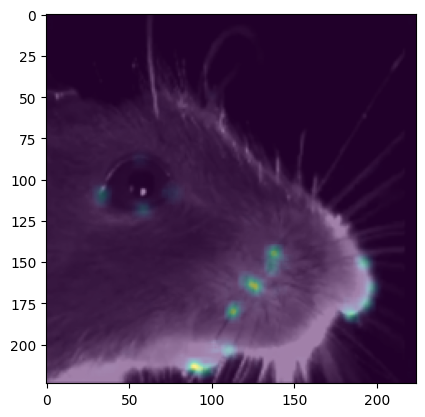

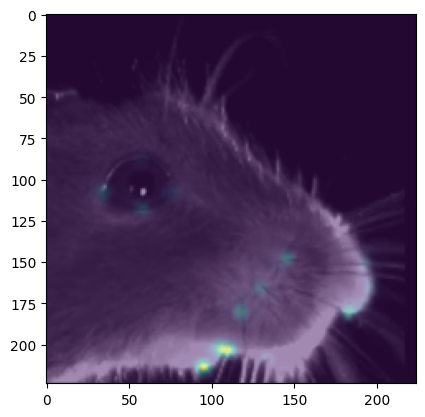

...

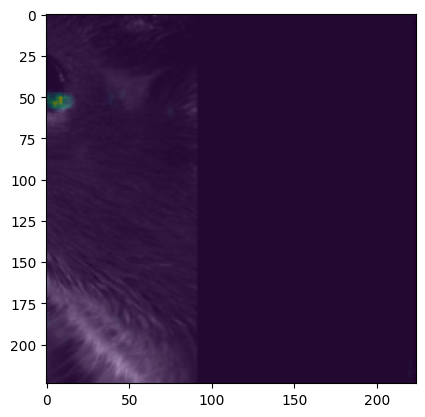

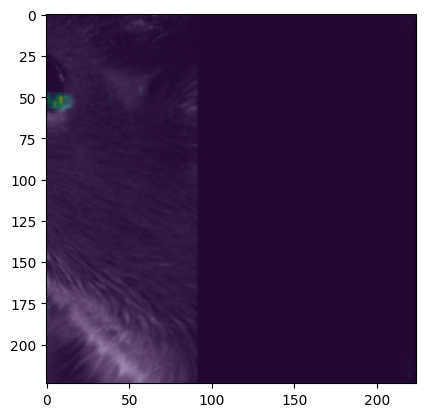

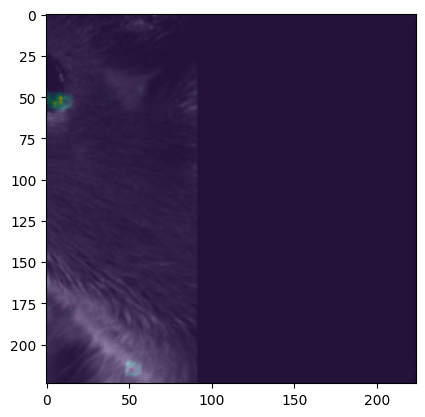

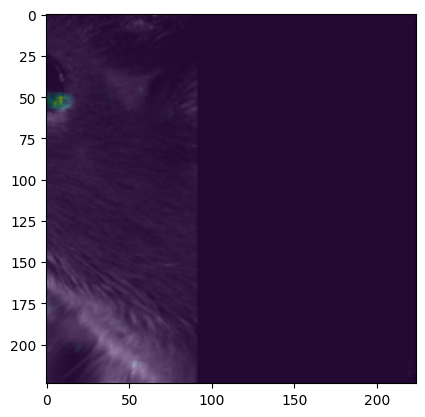

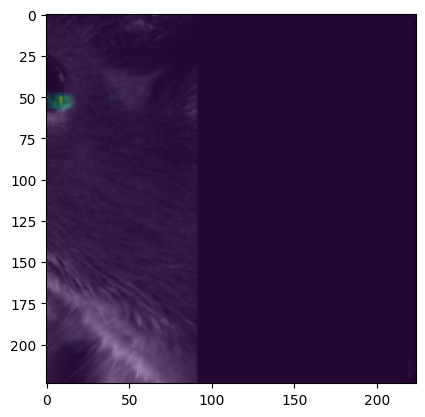

In [2]:
from PIL import Image
#USE THIS - still has error but produces images
# Initialize transformation for the video frames
vit_transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=1),  # Convert to grayscale
    transforms.ToTensor(),  # Convert image to tensor
])

IMG_LOC = r'C:\Users\avs20\Documents\GitHub\facemap\combined_images'

# Create the directory if it doesn't exist
os.makedirs(IMG_LOC, exist_ok=True)
print(f"Directory '{IMG_LOC}' is ready.")

# Process each image file
for idx, img_file in enumerate(img_files):
    img = Image.open(img_file)
    img = img.convert("L")  # Convert to grayscale if not already
    target_size=224
    # Apply the crop
    crop_size = min(img.width, img.height)
    left = 600
    top = 0
    img_cropped = img.crop((left, top, left + crop_size, top + crop_size))

    # Resize the cropped image
    img_resized = img_cropped.resize((target_size, target_size))

    # Apply transformation (convert to tensor)
    img_tensor = vit_transform(img_resized).unsqueeze(0).to(device)  # Add batch dimension and move to device

    # Model inference for keypoints
    with torch.no_grad():
        scores, fmap = model(img_tensor)
        heatmap = scores.squeeze().cpu().numpy()

    # Plotting the heatmap
    fig, ax = plt.subplots()
    ax.imshow(img_tensor.squeeze().cpu().numpy(), cmap="gray")  # Display image in grayscale
    ax.imshow(heatmap, cmap='viridis', alpha=0.5)  # Overlay heatmap with transparency
    plt.savefig(os.path.join(IMG_LOC, f'combined_image_{idx}.png'), bbox_inches='tight', dpi=300)


In [3]:
import matplotlib.animation as animation

# Define image location
IMG_LOC = r'C:\Users\avs20\Documents\GitHub\facemap\combined_images'


# Find all jpg images in IMG_LOC
frames = sorted(glob.glob(os.path.join(IMG_LOC, '*.png')))


In [4]:
print(frames)

# Check if any images were found
if not frames:
    print("No .jpg images found in the specified directory.")
else:
    print(f"Found {len(img_files)} images.")

['C:\\Users\\avs20\\Documents\\GitHub\\facemap\\combined_images\\combined_image_0.png', 'C:\\Users\\avs20\\Documents\\GitHub\\facemap\\combined_images\\combined_image_1.png', 'C:\\Users\\avs20\\Documents\\GitHub\\facemap\\combined_images\\combined_image_10.png', 'C:\\Users\\avs20\\Documents\\GitHub\\facemap\\combined_images\\combined_image_100.png', 'C:\\Users\\avs20\\Documents\\GitHub\\facemap\\combined_images\\combined_image_101.png', 'C:\\Users\\avs20\\Documents\\GitHub\\facemap\\combined_images\\combined_image_102.png', 'C:\\Users\\avs20\\Documents\\GitHub\\facemap\\combined_images\\combined_image_103.png', 'C:\\Users\\avs20\\Documents\\GitHub\\facemap\\combined_images\\combined_image_104.png', 'C:\\Users\\avs20\\Documents\\GitHub\\facemap\\combined_images\\combined_image_105.png', 'C:\\Users\\avs20\\Documents\\GitHub\\facemap\\combined_images\\combined_image_106.png', 'C:\\Users\\avs20\\Documents\\GitHub\\facemap\\combined_images\\combined_image_107.png', 'C:\\Users\\avs20\\Docume

In [5]:
frames_2 = []
# Process each image file
for idx, img_file in enumerate(frames):  # Limit to first 10 images or adjust as necessary
    # Read the image
    img = io.imread(img_file)
    frames_2.append(img)

In [6]:
import imageio

# Define output path and fps (frames per second)
output_path = 'output_movie.mp4'
fps = 30

# Write images to the video
with imageio.get_writer(output_path, fps=fps) as video_writer:
    for frame in frames_2:
        video_writer.append_data(frame)

print(f"Video successfully saved at {output_path}")


IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (1277, 1253) to (1280, 1264) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).


Video successfully saved at output_movie.mp4


EVERYTHING ABOVE WORKS!!

